# GG4257 - Urban Analytics: A Toolkit for Sustainable Urban Development
## Lab Workbook No 5: Intro to Networks
---
Dr Fernando Benitez -  University of St Andrews - School of Geography and Sustainable Development - Iteration 2025

> **GOOD ACADEMIC PRACTICE**: As always, The University policy on Good Academic Practice applies. There are probably many ways to address the challenges in here or part of them. You are free to do research and find relevant resources, like the documentation website, if you cited them correctly. But I strongly advise not to use AI tools, most importantly because you won't learn/practice as you are supposed to.
>
>  If you are not aware of **our academic misconduct policy**, kindly take a quick look (Pag 8. https://www.st-ndrews.ac.uk/policy/academic-policies-assessment-examination-and-award-good-academic-practice/good-academic-practice-guidance-for-students-frequently-asked-questions.pdf)


# Challenge 1

It's time for you to apply everything you learned by analyzing a case study of FourSquare social Network. (Foursquare is a location-based online social network. The dataset contains a list of all of the user-to-user links)

Datasource: @inproceedings{gao2012exploring,
     title={Exploring social-historical ties on location-based social networks},
     author={Gao, Huiji and Tang, Jiliang and Liu, Huan},
     booktitle={Proceedings of the 6th International AAAI Conference on Weblogs and Social Media},
     year={2012}
}

- **Data**: `FS.csv` (avaliable in Moodle)

1. Read the FS network dataset.
2. Describe using the basic functions of the graph's size. Explore nodes and edges. Provide how many nodes and edges are present in the network.
3. The dataset generates a graph of 639.014 nodes, so it is massive and you won't see anything meaningful if you try to plot it. So you need to create a subset using the **degree centrality** to find out find the top 4 of the most important nodes, and use them to create a subset of the original network. 
4. Extract the degree centrality values and convert them into a list. Then, plot a histogram to visualize the distribution of node degrees in the original network.
5. Create a plot for the subset created.
6. Now calculate another relevant measure of the network -- **betweenness centrality**. Plot the betweenness centrality distribution of the subset you created. Tip: Same steps from the previous step, but use `nx.betweenness_centrality()`
7. Plot the Matrix, Arc and Circos from the subset.

In [76]:
#Uncomment the following line to install Networkx, in case you don't have it
#pip install networkx

In [77]:
#pip install nxviz
#Uncomment the previous line in case you don't have nxviz

In [3]:
# Part 1- read the foursquare dataset
# just a csv
import pickle
import warnings
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx

foursquare = pd.read_csv("data/fs.csv")
foursquare.head()

,source,target
0,34802,0
1,48213,0
2,52194,0
3,67112,0
4,72662,0


In [4]:
# Create a network from this using nx.from_pandas_edgelist.
foursquare_network = nx.from_pandas_edgelist(foursquare[['source', 'target']], create_using=nx.Graph())
foursquare_network

In [4]:
print(len(foursquare_network))# Tells you the size of the graph.
print(type(foursquare_network.nodes())) # Tells you the type of nodes.
print(list(foursquare_network.edges(data=True))[-1]) # Read the attributes associated with the last element of the edges list. 
print(list(foursquare_network.nodes(data=True))[0]) # Read the attributes associated with the first element of the node list.
print(type(list(foursquare_network.edges(data=True))[-1][2])) # Which type; therefore, you can see what you are reading.

639014
<class 'networkx.classes.reportviews.NodeView'>
(94306, 128953, {})
(34802, {})
<class 'dict'>


From these results, there are 639014 nodes present. The nodes are a networkx class- with the last element of the edges list being associated with (94306, 128953, {}) and the first element being associated with (34802, {}). The datatype is a dictionary class.

In [5]:
#number of nodes and edges;
number_of_nodes = len(foursquare_network.nodes())
number_of_edges = len(foursquare_network.edges())

print("Number of nodes =",number_of_nodes,".")
print("Number of edges =",number_of_edges,".")

Number of nodes = 639014 .
Number of edges = 3214986 .


In [54]:
# Step 3- find the subset with the top four most important nodes;
# To first find the most important nodes, we need to calculate degree centrality then, sort descending.
degCent = nx.degree_centrality(foursquare_network) # This calculates centrality.
degCent_sorted=dict(sorted(degCent.items(), key=lambda item: item[1],reverse=True)) # This sorts them in order
#degCent_sorted # View a list of the sorted nodes to subset the four most important nodes. Sorted by highest to lowest degree centrality. Then, place top 4 manually.
# Commented out to save space.

In [11]:
# From this, the four top nodes are 106223, 89302, 76517 and 66999.
# So, now I can subset them.
edges_from_top_4=foursquare_network.edges([106223,89302,76517,66999])
# Now, they are subsetted. However, plotting this subset may be difficult due to size. Will choose another.

In [9]:
# Convert the original full dataset into a list.
degCent_list = list(nx.degree_centrality(foursquare_network).values())

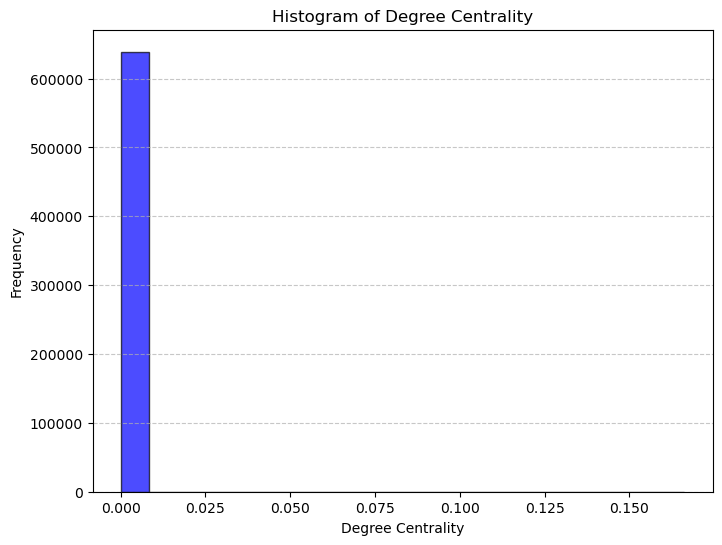

In [10]:
# Now, create a histogram using pyplot.
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.hist(degCent_list, bins=20, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel("Degree Centrality")
plt.ylabel("Frequency")
plt.title("Histogram of Degree Centrality")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show() # The degree centrality is very left skew.

In [43]:
# For plotting degree centrality, all the results are a bit too large.
# What I should do is choose only 40 edges max. The top 4 is over 100k...
# to find, I should filter
degree_dict = dict(foursquare_network.degree())
df = pd.DataFrame(list(degree_dict.items()), columns=["Node", "Number of Edges"])
print(df)

          Node  Number of Edges
0        34802               47
1            0               30
2        48213               26
3        52194               18
4        67112            45957
...        ...              ...
639009  482472                1
639010  482473                1
639011  482474                1
639012  465978                1
639013  465979                1

[639014 rows x 2 columns]


In [44]:
# Conveniently, node 34802 has 47 edges so, use that one.
edges_from_1=foursquare_network.edges([34802])

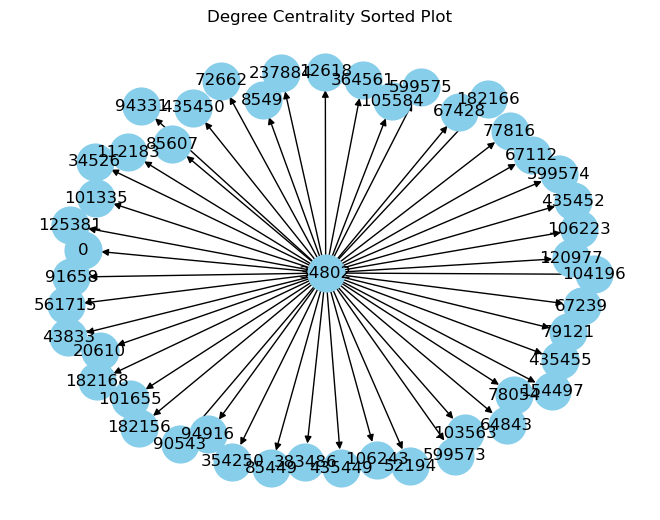

In [45]:
# Plot the graph of subset values
subgraph = nx.DiGraph()
subgraph.add_edges_from(edges_from_1)
pos = nx.spring_layout(subgraph)

#pos = nx.spring_layout(edges_from_1)
nx.draw(subgraph, pos, with_labels=True, node_size=700, node_color='skyblue')
plt.title('Degree Centrality Sorted Plot')
plt.show() # Only including the top four nodes.

In [46]:
# Plot the graph of the subset
Foursquare_sub = nx.DiGraph()
len(Foursquare_sub) # Creates a new empty graph

0

In [47]:
Foursquare_sub.add_edges_from(edges_from_1) # Adds edges from the subset
#Foursquare_sub.add_edges_from(foursquare_network) # Adds edges from the subset
len(Foursquare_sub)  #This is a bit big to plot... That is why it takes so long...

48

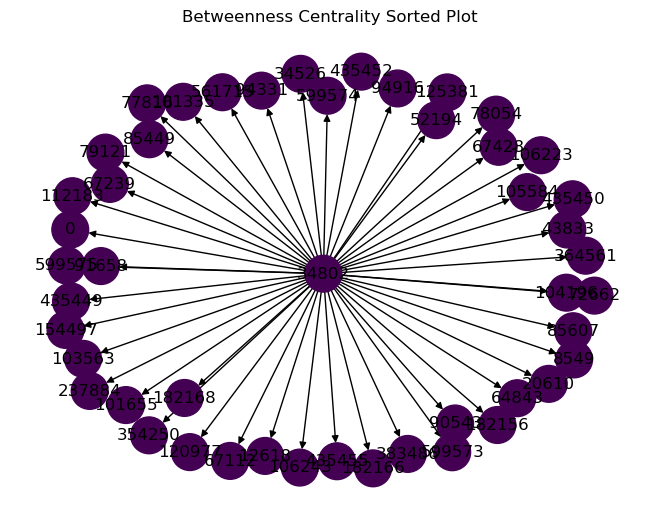

In [53]:
# Plot the graph for betweenness centrality
centrality = nx.betweenness_centrality(subgraph) # Add betweenness centrality.
nx.draw(subgraph, pos, node_color=list(centrality.values()), with_labels=True, node_size=700)
plt.title('Betweenness Centrality Sorted Plot')
plt.show() # Managed to plot, coloured by betweenness centrality.

C:\Applications\miniforge\envs\ua\Lib\site-packages\nxviz\api.py:275: UserWarning: As of nxviz 0.7, the object-oriented API is being deprecated in favour of a functional API. Please consider switching your plotting code! The object-oriented API wrappers remains in place to help you transition over. A few changes between the old and new API exist; please consult the nxviz documentation for more information. When the 1.0 release of nxviz happens, the object-oriented API will be dropped entirely.
  warnings.warn(


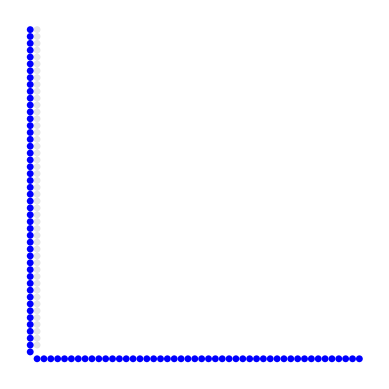

In [49]:
# Finally, matrix arc and circos plots, use the foursquare_sub graph above
# Matrix first
import nxviz as nv
nv.MatrixPlot(Foursquare_sub)
plt.show()

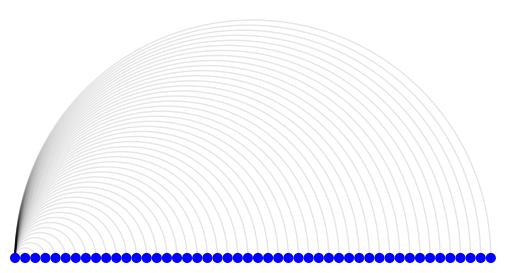

In [50]:
# now arc
a = nv.ArcPlot(Foursquare_sub)
plt.show()

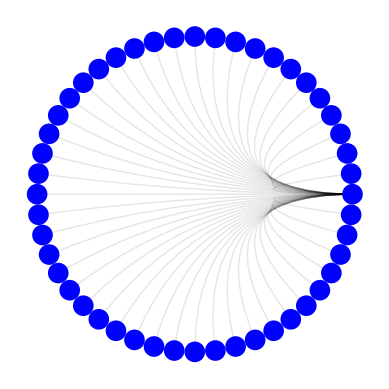

In [51]:
# finally circos
nv.CircosPlot(Foursquare_sub)
plt.show()

# Challenge 2

This challenge is about OSMnx. You will explore and analyze a city's street network using the OSMnx Python library.

1. Use OSMnx to download the street network of a city of your choice. You can specify the city name, BBox or a Dict.
2. Calculate basic statistics for the street network, such as the number of nodes, edges, average node degree, etc.
3. Use OSMnx to plot the street network. Customize the plot to make it visually appealing, including node size, edge color. See the potential options here: https://osmnx.readthedocs.io/en/stable/user-reference.html#module-osmnx.plot
4. Utilize the routing capabilities of OSMnx to find the shortest path between two points in the street network. Plot the route on top of the street network.
5. Calculate the centrality measures (e.g., degree centrality and betweenness_centrality) for nodes in the street network.
6. Create the figure-groud from the selected city
7. Create interactive maps to plot nodes, edges, nodes+edges and one of the centrality measures.
8. Export the street network to a GeoPackage (.gpkg) file. Ensure that the exported file contains both node and edge attributes. Demonstrate that the new GeoPackage can be used and read in Python using any of the libraries we have seen in the class to create a simple and interactive map.
9. Finally, use OSMnx to extract other urban elements (e.g., buildings, parks) and plot them.

In [1]:
#pip install osmnx
#Install this package in case it is needed.

In [55]:
# Importing packages
import osmnx as ox
from IPython.display import Image

### The city I choose for this is going to be Dijon, France (as it has a number of features yet, is not so big that analysis will take a long time to run.

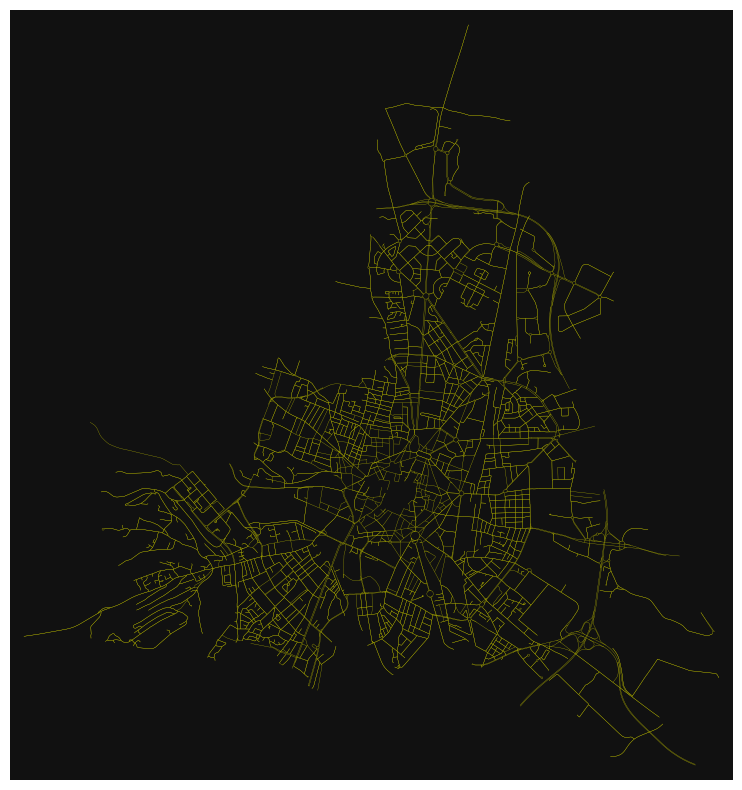

In [57]:
chosen_place = ("Dijon, France") # create variable chosen_place.
City = ox.graph_from_place(chosen_place, network_type="drive", truncate_by_edge=True)
fig, ax = ox.plot_graph(City, figsize=(10, 10), node_size=0, edge_color="y", edge_linewidth=0.2)

In [59]:
# For basic stats
import warnings
warnings.filterwarnings('ignore') # Filter out warnings
City_proj = ox.project_graph(City) # First, project the city

City_nodes_proj = ox.graph_to_gdfs(City_proj, edges=False) # Get a gdfs for nodes.
City_area = City_nodes_proj.unary_union.convex_hull.area # Then, calculate the area of the city.

ox.basic_stats(City, area=City_area, clean_int_tol=15) # Use the area for basic stats.

{'n': 3299,
 'm': 7457,
 'k_avg': 4.520763867838739,
 'edge_length_total': 766876.7959999958,
 'edge_length_avg': 102.83985463322996,
 'streets_per_node_avg': 2.9836314034555924,
 'streets_per_node_counts': {0: 0,
  1: 322,
  2: 55,
  3: 2346,
  4: 519,
  5: 46,
  6: 10,
  7: 1},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.09760533494998484,
  2: 0.016671718702637162,
  3: 0.7111245832070324,
  4: 0.15732040012124887,
  5: 0.013943619278569264,
  6: 0.003031221582297666,
  7: 0.0003031221582297666},
 'intersection_count': 2977,
 'street_length_total': 482670.750000001,
 'street_segment_count': 4858,
 'street_length_avg': 99.35585631947323,
 'circuity_avg': 1.046682718464339,
 'self_loop_proportion': 0.003499382461918485,
 'clean_intersection_count': 1,
 'node_density_km': 52.515469927166855,
 'intersection_density_km': 47.38967989486987,
 'edge_density_km': 12207.606947008138,
 'street_density_km': 7683.443848544444,
 'clean_intersection_density_km': 0.01591860258477322}

##### Here, there are 3299 nodes and 7457 edges present in the city. The average node degree is 4.520763867838739 degrees.

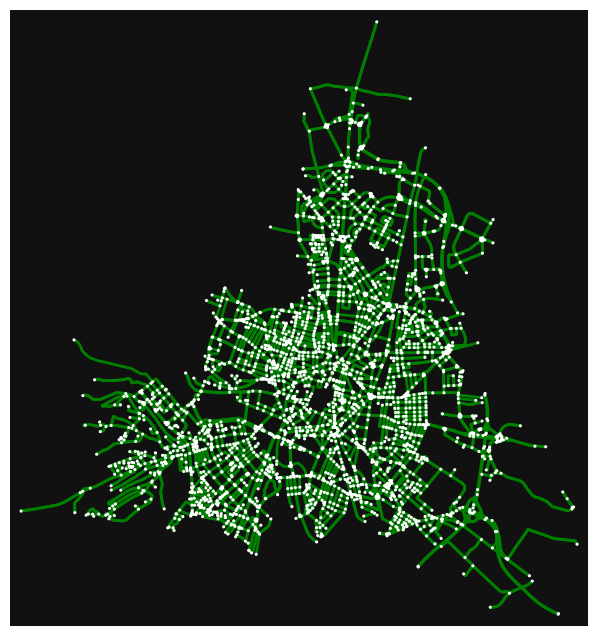

In [60]:
# Plotting the streets. Make the streets green and nodes white.
fig, ax = ox.plot_graph(City, edge_color="green", node_size=5, edge_linewidth=2) # Linewidth of 2 and node size of 5 to avoid nodes being too bid.

In [61]:
# Now for the routing. I need speed and travel times.
City = ox.speed.add_edge_speeds(City)
City = ox.speed.add_edge_travel_times(City)

In [62]:
# Nearest nodes to two random points in Stirling (google maps)
orig = ox.distance.nearest_nodes(City, X=5.040500497908517, Y=47.35272318031393)
dest = ox.distance.nearest_nodes(City, X=5.067833079566882, Y=47.30695042085872)

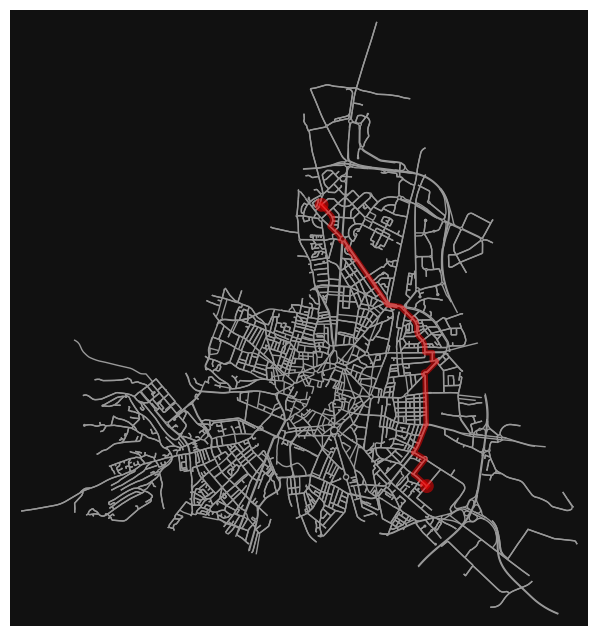

In [63]:
# Plot the shortest route by travel time.
route = ox.shortest_path(City, orig, dest, weight="travel_time")
fig, ax = ox.plot_graph_route(City, route, node_size=0)

In [64]:
# basic stats for the distance
edge_lengths = ox.utils_graph.route_to_gdf(City, route)["length"]
round(sum(edge_lengths)) # 6587 metres for route.

6587

In [65]:
# For crow flies distance,
orig_x = City.nodes[orig]["x"]
orig_y = City.nodes[orig]["y"]
dest_x = City.nodes[dest]["x"]
dest_y = City.nodes[dest]["y"]
round(ox.distance.great_circle(orig_y, orig_x, dest_y, dest_x)) # 5413 metres.

5413

In [66]:
# City centrality measures
city_betweenness_centrality = nx.betweenness_centrality(City, weight="length") # for betweenness centrality
city_degree_centrality = nx.degree_centrality(City) # for degree centrality


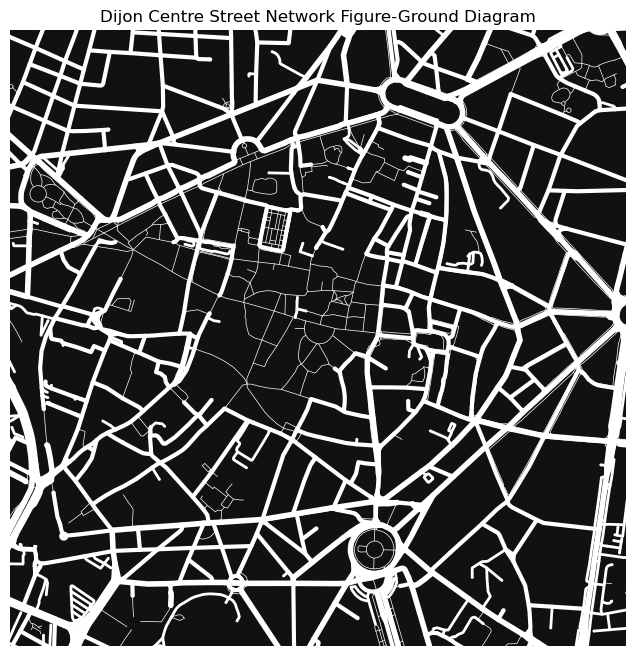

In [71]:
# figure-ground map of Dijon
place = "Dijon_centre" 
point = (47.321124470757695, 5.041364140196936)
# also define street widths
street_widths = {
    "footway": 0.5,
    "steps": 0.5,
    "pedestrian": 0.5,
    "path": 0.5,
    "track": 0.5,
    "service": 2,
    "residential": 3,
    "primary": 5,
    "motorway": 6,
}
fig, ax = ox.plot_figure_ground(
    point=point,
    filepath="images/Dijon_centre.png",
    street_widths=street_widths,
    network_type="all", # make it everything.
    save=True,
    show=False,
)
ax.set_title('Dijon Centre Street Network Figure-Ground Diagram'), # set the title.
plt.show()

In [72]:
# Now for interactive
# nodes
nodes_city = ox.graph_to_gdfs(City, edges=False)
nodes_city.explore(tiles="cartodbpositron", marker_kwds={"radius": 8})

### Outcome Screenshot
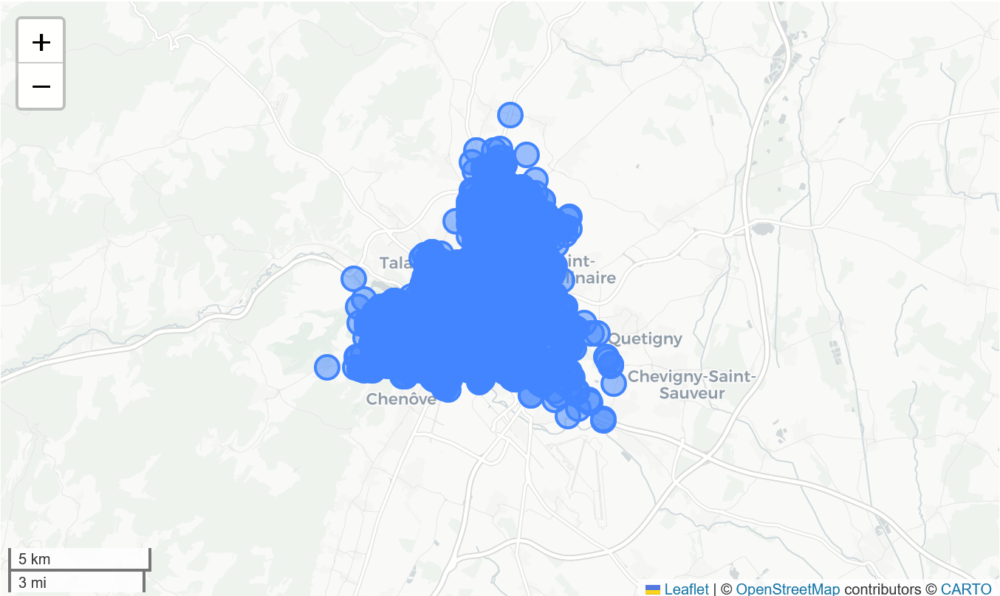

In [73]:
# edges
edges_city = ox.graph_to_gdfs(City, nodes=False)
edges_city.explore(tiles="cartodbpositron")

### Outcome Screenshot:
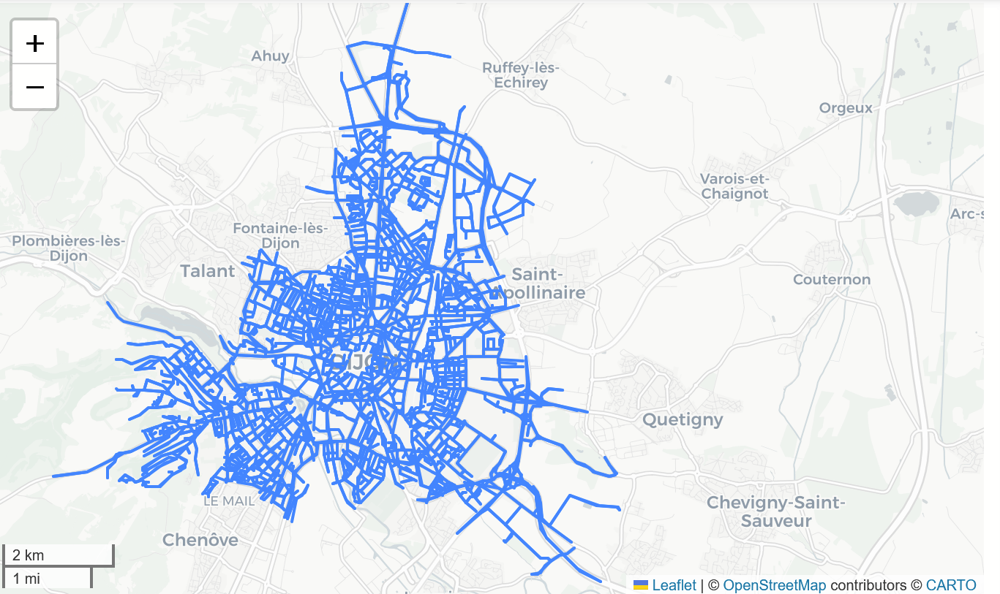

In [74]:
# nodes plus edges
nodes, edges = ox.graph_to_gdfs(City)
m = edges.explore(color="blue", tiles="cartodbpositron")
nodes.explore(m=m, color="red", marker_kwds={"radius": 6})

### Outcome Screenshot:
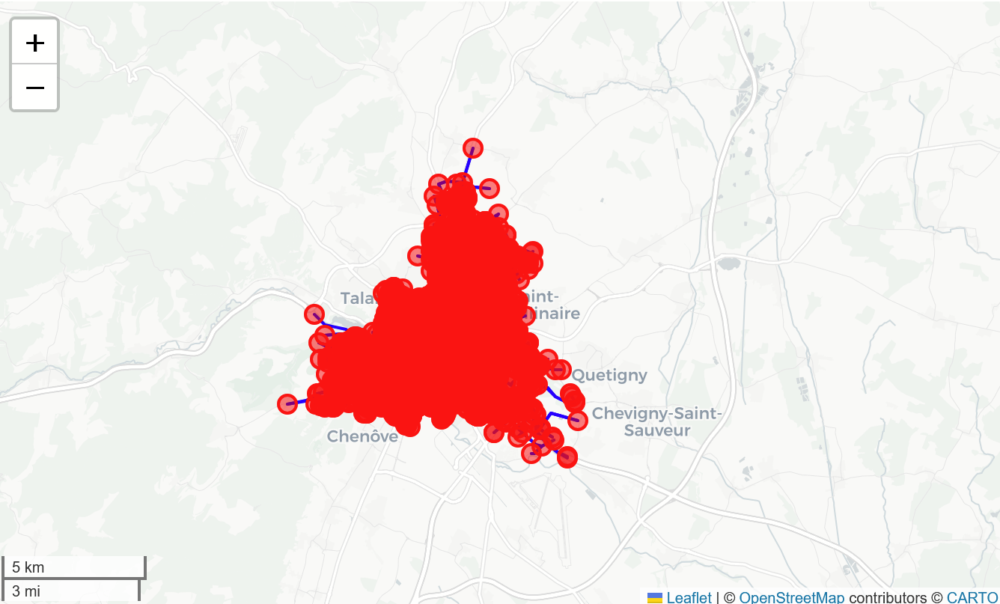

In [116]:
# finally nodes by degree centrality. 
nx.set_node_attributes(City, nx.degree_centrality(City), name="bc") # Calculate degree centrality for this.
nodes = ox.graph_to_gdfs(City, edges=False) # Set the nodes.
nodes.explore(tiles="cartodbpositron", column="bc", marker_kwds={"radius": 8}) # Create the map.

### Outcome Screenshot:
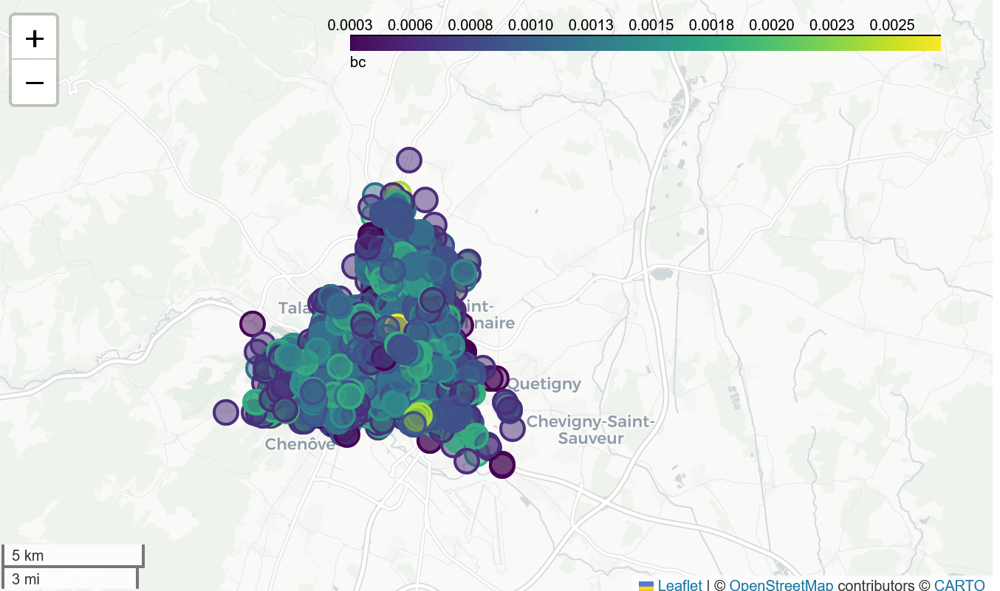

In [117]:
# Export the street network to a GeoPackage file;
ox.save_graph_geopackage(G, filepath="./data/dijon_network.gpkg")

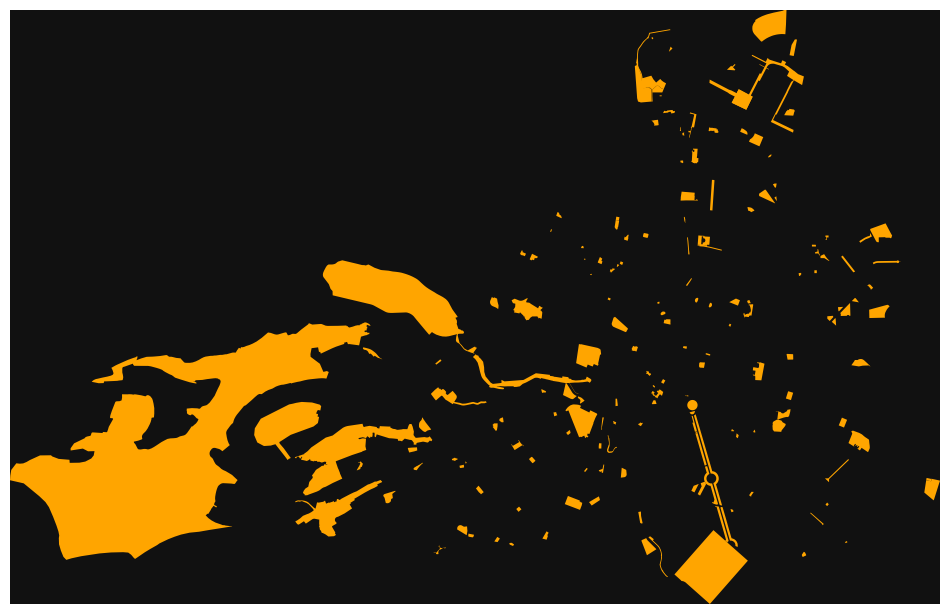

In [125]:
# Final maps, for parks
tags = {"leisure": "park"} # set a tag for parks. Set a leisure area first then, parks in particular.
city_parks = ox.features_from_place(chosen_place, tags) # chosen_place was defined earlier.
warnings.simplefilter('ignore', DeprecationWarning) 
fig, ax = ox.plot_footprints(city_parks, figsize=(12, 10))